In [1]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

from datetime import timedelta, datetime
#import holidays

import matplotlib
import pickle

In [2]:
import plotly.express as px
import matplotlib.pyplot as plt

In [3]:
matplotlib.pyplot.style.use('ggplot')
%matplotlib inline

In [4]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.float_format', lambda x: '%.6f' % x)
pd.set_option('display.width', 500)

In [5]:
targets_train = pd.read_csv('../../data/targets_train.csv')
uf_test = pd.read_csv('../../data/user_features_test.csv')
uf_train = pd.read_csv('../../data/user_features_train.csv')
users_test = pd.read_csv('../../data/users_test.csv')
users_train = pd.read_csv('../../data/users_train.csv')

In [6]:
df_train = pd.merge(targets_train, users_train, on='ID')

In [7]:
df_train = pd.merge(df_train, uf_train, on='ID')

In [8]:
df_test = pd.merge(users_test, uf_test, on='ID')

In [9]:
df_train.shape

(878594, 87)

In [10]:
df_test.shape

(585730, 86)

In [11]:
df_train['first_prediction'].min()

0.0001000165994469

In [12]:
df_train['log_first_prediction'] = np.log(df_train['first_prediction'])

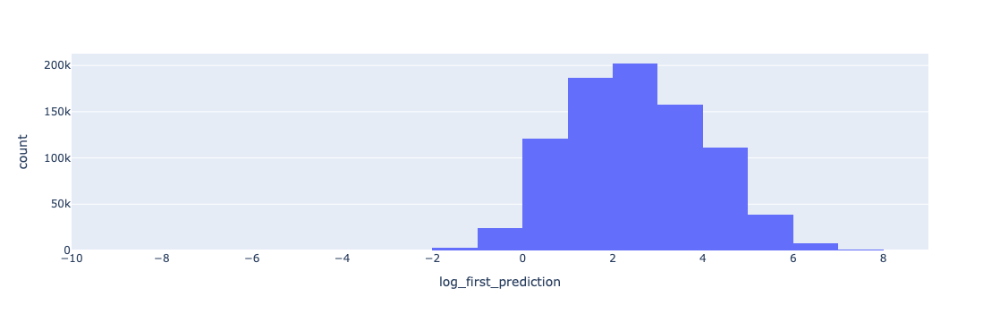

In [13]:
fig = px.histogram(df_train, x="log_first_prediction", nbins=20)
fig.show()

In [14]:
df_train['log_first_prediction'].describe()

count   852859.000000
mean         2.501908
std          1.512796
min         -9.210174
25%          1.369290
50%          2.434890
75%          3.580081
max          8.506026
Name: log_first_prediction, dtype: float64

In [15]:
df_train['economic_class'] = np.where((0.0 > round(df_train['log_first_prediction'], 1)), 'poor', 'Nan')
df_train['economic_class'] = np.where((0.0 <= round(df_train['log_first_prediction'], 1)) & 
                                      ((round(df_train['log_first_prediction'], 1) < 2.5)), 'lower_middle_class', df_train['economic_class'])
df_train['economic_class'] = np.where((2.5 <= round(df_train['log_first_prediction'], 1)) & 
                                      ((round(df_train['log_first_prediction'], 1) <= 5.0)), 'upper_middle_class', df_train['economic_class'])
df_train['economic_class'] = np.where((5.0 < round(df_train['log_first_prediction'], 1)), 'wealthy', df_train['economic_class'])

In [16]:
df_train['economic_class'].value_counts()

economic_class
lower_middle_class    404918
upper_middle_class    387587
wealthy                35752
Nan                    25735
poor                   24602
Name: count, dtype: int64

In [17]:
LvlDuration_cols = ['Level_1_Duration', 'Level_2_Duration', 'Level_3_Duration', 'Level_4_Duration', 'Level_5_Duration', 
                   'Level_6_Duration', 'Level_7_Duration', 'Level_8_Duration', 'Level_9_Duration', 'Level_10_Duration']

df_train[LvlDuration_cols] = df_train[LvlDuration_cols].fillna(0.0)

df_train['Retention_count_D0_3'] = (df_train['RetentionD0'].astype(int) + df_train['RetentionD1'].astype(int) + 
                                        df_train['RetentionD2'].astype(int) + df_train['RetentionD3'].astype(int))
df_train['Retention_count_D4_7'] = (df_train['RetentionD4'].astype(int) + df_train['RetentionD5'].astype(int) + 
                                        df_train['RetentionD6'].astype(int) + df_train['RetentionD7'].astype(int))

df_train['Retention_count_D8_11'] = (df_train['RetentionD8'].astype(int) + df_train['RetentionD9'].astype(int) + 
                                        df_train['RetentionD10'].astype(int) + df_train['RetentionD11'].astype(int))

df_train['Retention_count_D12_15'] = (df_train['RetentionD12'].astype(int) + df_train['RetentionD13'].astype(int) + 
                                        df_train['RetentionD14'].astype(int) + df_train['RetentionD15'].astype(int))
df_train['Avg_Lvl_Count_D0_3'] = (df_train['LevelAdvancedCountD0'] + df_train['LevelAdvancedCountD1'] +
                                 df_train['LevelAdvancedCountD2'] + df_train['LevelAdvancedCountD3']) / 4.0
df_train['Avg_Lvl_Count_D4_7'] = (df_train['LevelAdvancedCountD4'] + df_train['LevelAdvancedCountD5'] +
                                 df_train['LevelAdvancedCountD6'] + df_train['LevelAdvancedCountD7']) / 4.0

df_train['Avg_Lvl_Count_D8_11'] = (df_train['LevelAdvancedCountD8'] + df_train['LevelAdvancedCountD9'] +
                                 df_train['LevelAdvancedCountD10'] + df_train['LevelAdvancedCountD11']) / 4.0

df_train['Avg_Lvl_Count_D12_15'] = (df_train['LevelAdvancedCountD12'] + df_train['LevelAdvancedCountD13'] +
                                 df_train['LevelAdvancedCountD14'] + df_train['LevelAdvancedCountD15']) / 4.0
df_train['Avg_Duration_Lvl0_3'] = (df_train['Level_1_Duration'] + df_train['Level_2_Duration'] +
                                 df_train['Level_3_Duration']) / 3.0

df_train['Avg_Duration_Lvl4_7'] = (df_train['Level_4_Duration'] + df_train['Level_5_Duration'] +
                                 df_train['Level_6_Duration'] + df_train['Level_7_Duration']) / 4.0

df_train['Avg_Duration_Lvl8_10'] = (df_train['Level_8_Duration'] + df_train['Level_9_Duration'] +
                                 df_train['Level_10_Duration']) / 3.0
df_train['Total_AdRevenueD0_3'] = (df_train['AdRevenueD0'] + df_train['AdRevenueD1'] + 
                                        df_train['AdRevenueD2'] + df_train['AdRevenueD3'])

df_train['Total_AdRevenueD4_7'] = (df_train['AdRevenueD4'] + df_train['AdRevenueD5'] + 
                                        df_train['AdRevenueD6'] + df_train['AdRevenueD7'])

df_train['Total_AdRevenueD8_11'] = (df_train['AdRevenueD8'] + df_train['AdRevenueD9'] + 
                                        df_train['AdRevenueD10'] + df_train['AdRevenueD11'])

df_train['Total_AdRevenueD12_15'] = (df_train['AdRevenueD12'] + df_train['AdRevenueD13'] + 
                                        df_train['AdRevenueD14'] + df_train['AdRevenueD15'])
df_train['Total_IAPRevenueD0_3'] = (df_train['IAPRevenueD0'] + df_train['IAPRevenueD1'] + 
                                        df_train['IAPRevenueD2'] + df_train['IAPRevenueD3'])

df_train['Total_IAPRevenueD4_7'] = (df_train['IAPRevenueD4'] + df_train['IAPRevenueD5'] + 
                                        df_train['IAPRevenueD6'] + df_train['IAPRevenueD7'])

df_train['Total_IAPRevenueD8_11'] = (df_train['IAPRevenueD8'] + df_train['IAPRevenueD9'] + 
                                        df_train['IAPRevenueD10'] + df_train['IAPRevenueD11'])

df_train['Total_IAPRevenueD12_15'] = (df_train['IAPRevenueD12'] + df_train['IAPRevenueD13'] + 
                                        df_train['IAPRevenueD14'] + df_train['IAPRevenueD15'])
df_train['Total_AdRevenue'] = df_train['Total_AdRevenueD0_3'] + df_train['Total_AdRevenueD4_7'] + df_train['Total_AdRevenueD8_11'] + df_train['Total_AdRevenueD12_15']

df_train['Total_IAPRevenue'] = df_train['Total_IAPRevenueD0_3'] + df_train['Total_IAPRevenueD4_7'] + df_train['Total_IAPRevenueD8_11'] + df_train['Total_IAPRevenueD12_15']

df_train['first_open_date'] = pd.to_datetime(df_train['first_open_date'], format='%Y-%m-%d')

df_train['open_year'] = df_train['first_open_date'].apply(lambda x:x.year)
df_train['open_month'] = df_train['first_open_date'].apply(lambda x:x.month)

In [18]:
df_train['TARGET'] = df_train['TARGET'] - (df_train['Total_AdRevenue'] + df_train['Total_IAPRevenue'])

In [19]:
df_train[df_train['TARGET'] < 0.0].describe()

,ID,TARGET,first_open_date,first_open_timestamp,local_first_open_timestamp,first_prediction,LevelAdvancedCountD0,LevelAdvancedCountD1,LevelAdvancedCountD2,LevelAdvancedCountD3,LevelAdvancedCountD4,LevelAdvancedCountD5,LevelAdvancedCountD6,LevelAdvancedCountD7,LevelAdvancedCountD8,LevelAdvancedCountD9,LevelAdvancedCountD10,LevelAdvancedCountD11,LevelAdvancedCountD12,LevelAdvancedCountD13,LevelAdvancedCountD14,LevelAdvancedCountD15,Level_1_Duration,Level_2_Duration,Level_3_Duration,Level_4_Duration,Level_5_Duration,Level_6_Duration,Level_7_Duration,Level_8_Duration,Level_9_Duration,Level_10_Duration,AdRevenueD0,AdRevenueD1,AdRevenueD2,AdRevenueD3,AdRevenueD4,AdRevenueD5,AdRevenueD6,AdRevenueD7,AdRevenueD8,AdRevenueD9,AdRevenueD10,AdRevenueD11,AdRevenueD12,AdRevenueD13,AdRevenueD14,AdRevenueD15,IAPRevenueD0,IAPRevenueD1,IAPRevenueD2,IAPRevenueD3,IAPRevenueD4,IAPRevenueD5,IAPRevenueD6,IAPRevenueD7,IAPRevenueD8,IAPRevenueD9,IAPRevenueD10,IAPRevenueD11,IAPRevenueD12,IAPRevenueD13,IAPRevenueD14,IAPRevenueD15,log_first_prediction,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,open_year,open_month
count,19061.000000,19061.000000,19061,19061.000000,19061.000000,19037.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19037.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000,19061.000000
mean,438009.547033,-0.000000,2024-03-10 15:19:06.235769088,1710113087416034.500000,1710105616769164.000000,72.432316,19.309690,10.081895,5.770107,3.946907,2.984523,2.251194,1.805729,1.526992,1.129636,0.928912,0.744924,0.641257,0.523530,0.394785,0.340381,0.216778,18.288023,75.881905,82.147369,111.299040,103.212161,118.715440,143.389644,126.579141,70.089764,139.511568,0.387189,0.219847,0.118901,0.078876,0.061373,0.046563,0.040243,0.030188,0.024446,0.018242,0.015608,0.013357,0.010123,0.008587,0.007796,0.005877,0.004876,0.002319,0.001193,0.000613,0.000306,0.000545,0.000205,0.000477,0.000000,0.000068,0.000136,0.000000,0.000000,0.000000,0.000341,0.000000,3.507230,2.505063,0.942028,0.471906,0.252400,9.777150,2.142110,0.861183,0.368868,58.772432,119.154071,112.060158,0.804812,0.178367,0.071653,0.032383,0.009001,0.001533,0.000205,0.000341,1.087215,0.011080,2024.000000,2.842925
min,33.000000,-0.000000,2024-01-01 00:00:00,1704058896550000.000000,1704039299303000.000000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000

In [20]:
df_train[df_train['TARGET'] < 0.0]['TARGET'].max()

-6.776263578034403e-21

In [21]:
df_train[df_train['TARGET'] < 0.0]['TARGET'].min()

-8.65085780787922e-13

In [22]:
df_train[df_train['TARGET'] > 0.0]['TARGET'].min()

1.6940658945086007e-21

In [23]:
df_train.loc[df_train['TARGET'] < 0.0, 'TARGET'] = 0.0

In [24]:
df_train[df_train['TARGET'] < 0.0].describe()

,ID,TARGET,first_open_date,first_open_timestamp,local_first_open_timestamp,first_prediction,LevelAdvancedCountD0,LevelAdvancedCountD1,LevelAdvancedCountD2,LevelAdvancedCountD3,LevelAdvancedCountD4,LevelAdvancedCountD5,LevelAdvancedCountD6,LevelAdvancedCountD7,LevelAdvancedCountD8,LevelAdvancedCountD9,LevelAdvancedCountD10,LevelAdvancedCountD11,LevelAdvancedCountD12,LevelAdvancedCountD13,LevelAdvancedCountD14,LevelAdvancedCountD15,Level_1_Duration,Level_2_Duration,Level_3_Duration,Level_4_Duration,Level_5_Duration,Level_6_Duration,Level_7_Duration,Level_8_Duration,Level_9_Duration,Level_10_Duration,AdRevenueD0,AdRevenueD1,AdRevenueD2,AdRevenueD3,AdRevenueD4,AdRevenueD5,AdRevenueD6,AdRevenueD7,AdRevenueD8,AdRevenueD9,AdRevenueD10,AdRevenueD11,AdRevenueD12,AdRevenueD13,AdRevenueD14,AdRevenueD15,IAPRevenueD0,IAPRevenueD1,IAPRevenueD2,IAPRevenueD3,IAPRevenueD4,IAPRevenueD5,IAPRevenueD6,IAPRevenueD7,IAPRevenueD8,IAPRevenueD9,IAPRevenueD10,IAPRevenueD11,IAPRevenueD12,IAPRevenueD13,IAPRevenueD14,IAPRevenueD15,log_first_prediction,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,open_year,open_month
count,0.000000,0.000000,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
mean,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [25]:
np.log(1.0e-22)

-50.65687204586901

In [26]:
df_train['log_TARGET'] = np.log(df_train['TARGET']+ 1.0e-22)

In [27]:
df_train_grande = df_train.copy()

In [28]:
df_train = df_train[['ID', 'TARGET', 'open_year', 'open_month', 'first_prediction', 'log_first_prediction', 'economic_class', 'log_TARGET',
         'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
         'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15', 'Avg_Duration_Lvl0_3',
         'Avg_Duration_Lvl4_7', 'Avg_Duration_Lvl8_10', 'Total_AdRevenueD0_3', 'Total_AdRevenueD4_7', 'Total_AdRevenueD8_11', 
         'Total_AdRevenueD12_15', 'Total_IAPRevenueD0_3', 'Total_IAPRevenueD4_7', 'Total_IAPRevenueD8_11', 'Total_IAPRevenueD12_15', 
                       'Total_AdRevenue', 'Total_IAPRevenue']]

In [29]:
df_train.groupby('economic_class')['TARGET'].mean()

economic_class
Nan                  0.016357
lower_middle_class   0.065885
poor                 0.028112
upper_middle_class   0.244419
wealthy              0.944412
Name: TARGET, dtype: float64

In [30]:
df_train.groupby('economic_class')['log_TARGET'].mean()

economic_class
Nan                  -48.648718
lower_middle_class   -33.058383
poor                 -31.650588
upper_middle_class   -33.120249
wealthy              -36.423691
Name: log_TARGET, dtype: float64

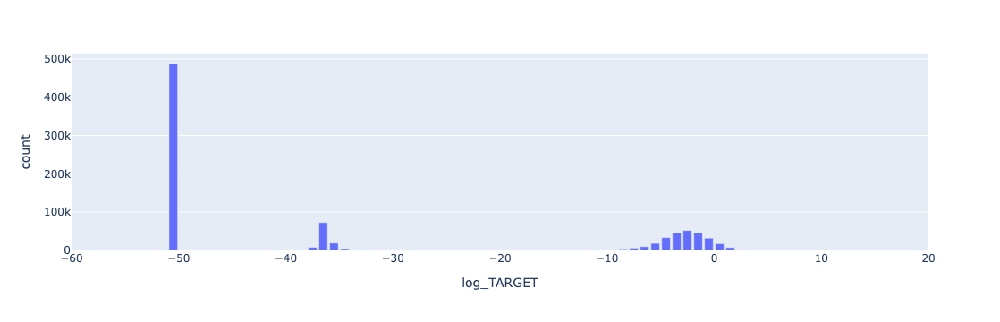

In [31]:
counts, bins = np.histogram(df_train['log_TARGET'], bins=range(-60, 21, 1))
bins = bins + 60
bins = 0.5 * (bins[:-1] + bins[1:])
bins = bins - 60
fig = px.bar(x=bins, y=counts, labels={'x':'log_TARGET', 'y':'count'})
fig.show()

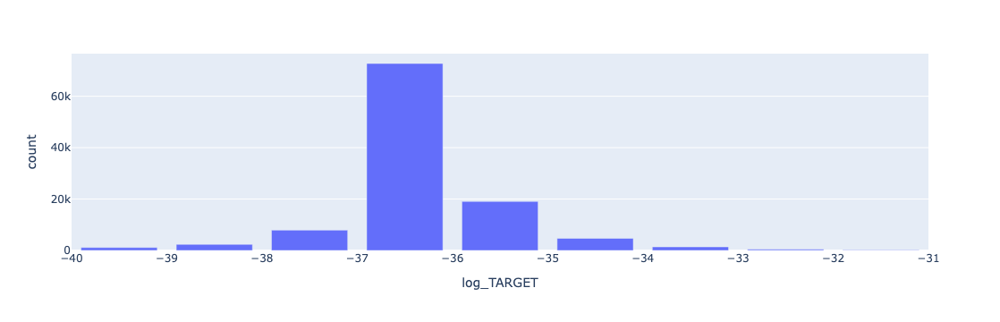

In [32]:
counts, bins = np.histogram(df_train['log_TARGET'], bins=range(-40, -30, 1))
# bins = bins + 10
bins = 0.5 * (bins[:-1] + bins[1:])
# bins = bins - 10
fig = px.bar(x=bins, y=counts, labels={'x':'log_TARGET', 'y':'count'})
fig.show()

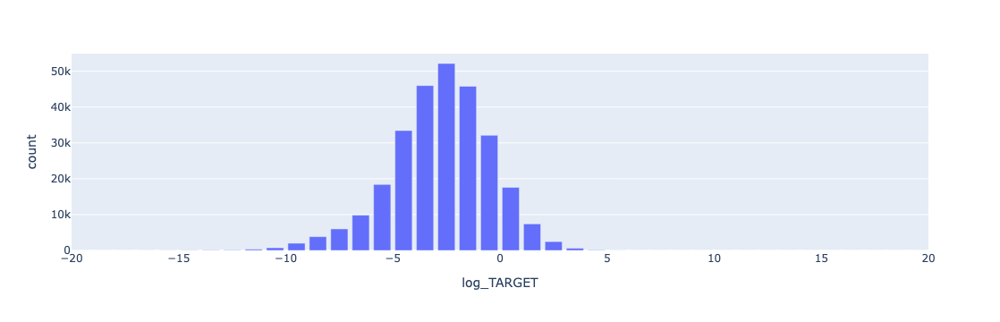

In [33]:
counts, bins = np.histogram(df_train['log_TARGET'], bins=range(-20, 21, 1))
bins = bins + 20
bins = 0.5 * (bins[:-1] + bins[1:])
bins = bins - 20
fig = px.bar(x=bins, y=counts, labels={'x':'log_TARGET', 'y':'count'})
fig.show()

**Round log_TARGET**

In [34]:
np.e**-30

9.35762296884019e-14

In [35]:
np.e**-31

3.4424771084699824e-14

In [36]:
np.log(1.0e-13)

-29.933606208922594

In [37]:
df_train[df_train['log_TARGET'] < -29.9].describe()

,ID,TARGET,open_year,open_month,first_prediction,log_first_prediction,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
count,599436.000000,599436.000000,599436.000000,599436.000000,574751.000000,574751.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000,599436.000000
mean,439437.933669,0.000000,2024.000000,2.898640,39.377864,2.526931,-48.012750,1.673877,0.391465,0.206771,0.122297,3.847806,0.692707,0.306189,0.150554,74.220236,97.019548,65.400499,0.148245,0.026097,0.010871,0.005147,0.001280,0.000156,0.000085,0.000066,0.190360,0.001587
std,253707.346073,0.000000,0.000000,1.377557,93.479058,1.518013,5.550761,0.917713,0.829098,0.595970,0.437340,6.533797,3.367302,2.125694,1.360092,113.437480,128.729154,111.969673,0.681125,0.252832,0.139087,0.092738,0.073808,0.019280,0.014962,0.014708,0.892037,0.084570
min,0.000000,0.000000,2024.000000,1.000000,0.000100,-9.210174,-50.656872,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,219685.750000,0.000000,2024.000000,2.000000,4.021435,1.391639,-50.656872,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,29.333333,17.750000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,439793.500000,0.000000,2024.000000,3.000000,11.638417,2.454311,-50.656872,1.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,52.666667,74.250000,40.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.002871,0.000000
75%,659341.500000,0.000000,2024.000000,4.000000,37.043763,3.612100,-50.656872,2.000000,0.000000,0.000000,0.000000,3.750000,0.000000,0.000000,0.000000,91.000000,138.750000,103.000000,0.062182,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.085296,0.000000
max,878593.000000,0.000000,2024.000000,5.000000,4944.476604,8.506026,-30.012968,4.000000,4.000000,4.000000,4.000000,353.000000,297.500000,214.000000,111.500000,29232.666667,8767.250000,14461.666667,91.707404,56.353756,22.095279,30.374176,27.950000,4.550000,5.200000,6.500000,129.768991,27.950000


In [38]:
df_train.loc[df_train['log_TARGET'] < -29.9, 'log_TARGET'] = -30.0

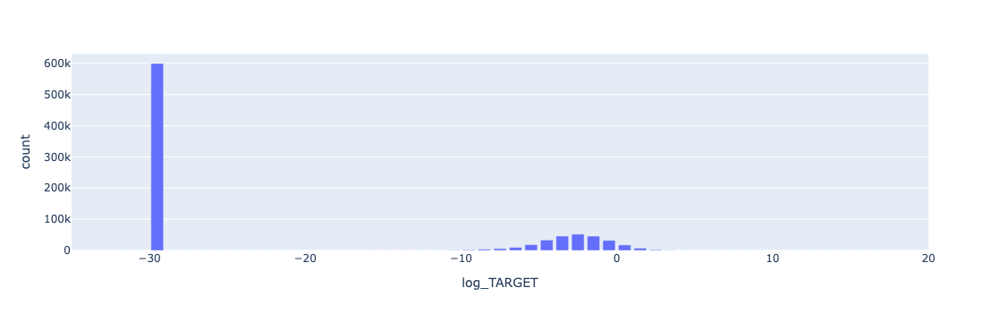

In [39]:
counts, bins = np.histogram(df_train['log_TARGET'], bins=range(-35, 21, 1))
bins = bins + 35
bins = 0.5 * (bins[:-1] + bins[1:])
bins = bins - 35
fig = px.bar(x=bins, y=counts, labels={'x':'log_TARGET', 'y':'count'})
fig.show()

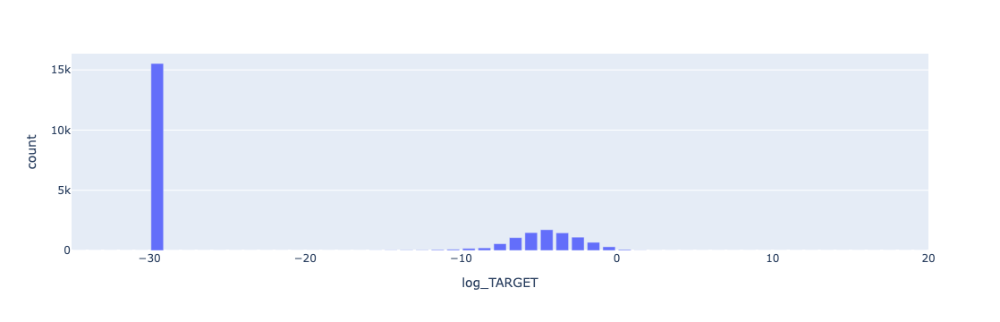

In [40]:
counts, bins = np.histogram(df_train[df_train['economic_class'] == 'poor']['log_TARGET'], bins=range(-35, 21, 1))
bins = bins + 35
bins = 0.5 * (bins[:-1] + bins[1:])
bins = bins - 35
fig = px.bar(x=bins, y=counts, labels={'x':'log_TARGET', 'y':'count'})
fig.show()

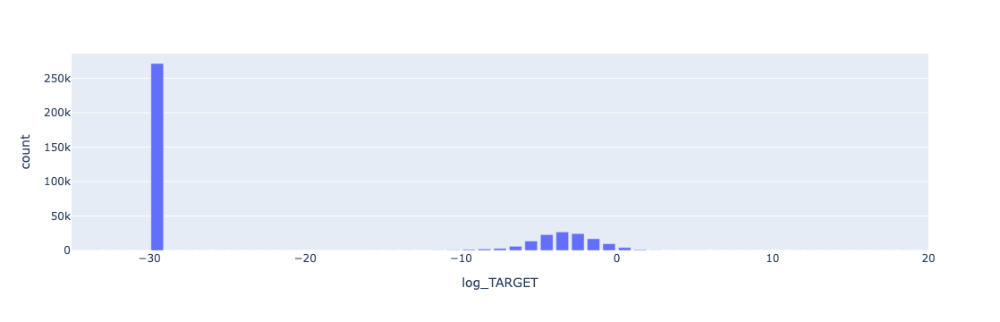

In [41]:
counts, bins = np.histogram(df_train[df_train['economic_class'] == 'lower_middle_class']['log_TARGET'], bins=range(-35, 21, 1))
bins = bins + 35
bins = 0.5 * (bins[:-1] + bins[1:])
bins = bins - 35
fig = px.bar(x=bins, y=counts, labels={'x':'log_TARGET', 'y':'count'})
fig.show()

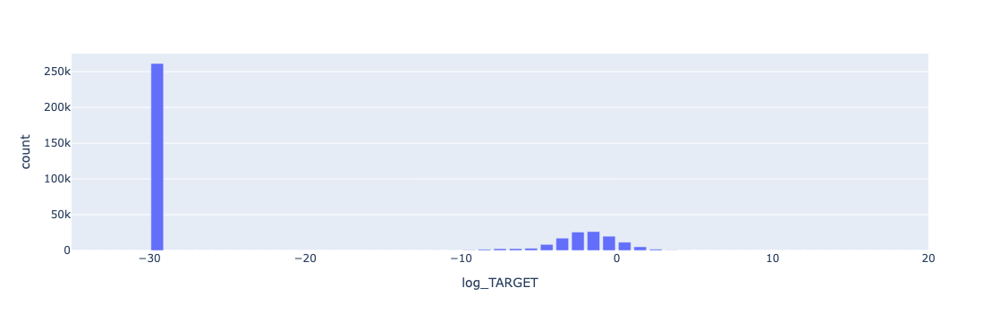

In [42]:
counts, bins = np.histogram(df_train[df_train['economic_class'] == 'upper_middle_class']['log_TARGET'], bins=range(-35, 21, 1))
bins = bins + 35
bins = 0.5 * (bins[:-1] + bins[1:])
bins = bins - 35
fig = px.bar(x=bins, y=counts, labels={'x':'log_TARGET', 'y':'count'})
fig.show()

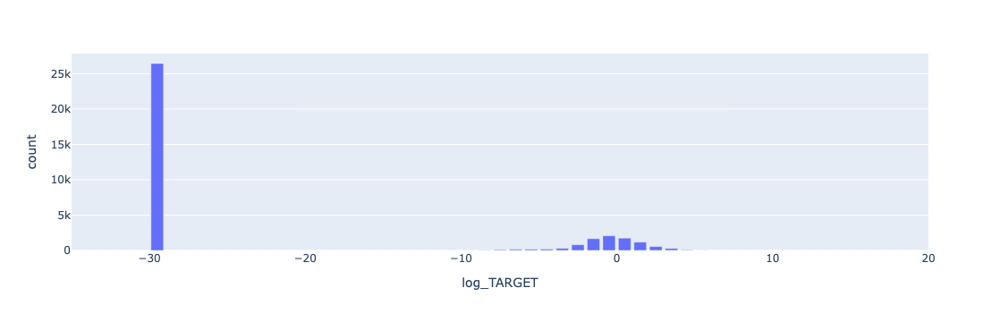

In [43]:
counts, bins = np.histogram(df_train[df_train['economic_class'] == 'wealthy']['log_TARGET'], bins=range(-35, 21, 1))
bins = bins + 35
bins = 0.5 * (bins[:-1] + bins[1:])
bins = bins - 35
fig = px.bar(x=bins, y=counts, labels={'x':'log_TARGET', 'y':'count'})
fig.show()

In [44]:
df_train_grande.head()

,ID,TARGET,first_open_date,first_open_timestamp,local_first_open_timestamp,country,platform,device_category,device_brand,device_model,has_ios_att_permission,ad_network,first_prediction,RetentionD0,RetentionD1,RetentionD2,RetentionD3,RetentionD4,RetentionD5,RetentionD6,RetentionD7,RetentionD8,RetentionD9,RetentionD10,RetentionD11,RetentionD12,RetentionD13,RetentionD14,RetentionD15,LevelAdvancedCountD0,LevelAdvancedCountD1,LevelAdvancedCountD2,LevelAdvancedCountD3,LevelAdvancedCountD4,LevelAdvancedCountD5,LevelAdvancedCountD6,LevelAdvancedCountD7,LevelAdvancedCountD8,LevelAdvancedCountD9,LevelAdvancedCountD10,LevelAdvancedCountD11,LevelAdvancedCountD12,LevelAdvancedCountD13,LevelAdvancedCountD14,LevelAdvancedCountD15,Level_1_Duration,Level_2_Duration,Level_3_Duration,Level_4_Duration,Level_5_Duration,Level_6_Duration,Level_7_Duration,Level_8_Duration,Level_9_Duration,Level_10_Duration,AdRevenueD0,AdRevenueD1,AdRevenueD2,AdRevenueD3,AdRevenueD4,AdRevenueD5,AdRevenueD6,AdRevenueD7,AdRevenueD8,AdRevenueD9,AdRevenueD10,AdRevenueD11,AdRevenueD12,AdRevenueD13,AdRevenueD14,AdRevenueD15,IAPRevenueD0,IAPRevenueD1,IAPRevenueD2,IAPRevenueD3,IAPRevenueD4,IAPRevenueD5,IAPRevenueD6,IAPRevenueD7,IAPRevenueD8,IAPRevenueD9,IAPRevenueD10,IAPRevenueD11,IAPRevenueD12,IAPRevenueD13,IAPRevenueD14,IAPRevenueD15,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,open_year,open_month,log_TARGET
0,0,0.000000,2024-03-02,1709355895042000,1709334295042000,Mexico,Android,mobile,Xiaomi,Redmi A2,False,unityads_int,3.314099,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,26.000000,69.000000,36.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.198186,lower_middle_class,1,0,0,1,0.750000,0.000000,0.000000,0.000000,43.666667,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2024,3,-50.656872
1,1,0.000000,2024-03-19,1710824539731000,1710806539731000,Peru,Android,mobile,Samsung,Galaxy A13,False,applovin_int,1.681524,True,False,False,False,False,False,True,True,False,True,False,False,False,False,False,False,5,0,0,0,0,0,3,5,0,2,0,0,0,0,0,0,13.000000,91.000000,39.000000,79.000000,180.000000,89.000000,124.000000,118.000000,35.000000,117.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.008674,0.000000,0.010218,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.519701,lower_middle_class,1,2,1,0,1.250000,2.000000,0.500000,0.000000,47.666667,118.000000,90.000000,0.000000,0.008674,0.010218,0.000000,0.000000,0.000000,0.000000,0.000000,0.018892,0.000000,2024,3,-36.835240
2,2,0.000000,2024-03-18,1710731043082000,1710720243082000,Brazil,Android,mobile,Xiaomi,Redmi 12,False,applovin_int,10.718750,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,8.000000,63.000000,86.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000

In [45]:
df_train.head()

,ID,TARGET,open_year,open_month,first_prediction,log_first_prediction,economic_class,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
0,0,0.000000,2024,3,3.314099,1.198186,lower_middle_class,-30.000000,1,0,0,1,0.750000,0.000000,0.000000,0.000000,43.666667,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,1,0.000000,2024,3,1.681524,0.519701,lower_middle_class,-30.000000,1,2,1,0,1.250000,2.000000,0.500000,0.000000,47.666667,118.000000,90.000000,0.000000,0.008674,0.010218,0.000000,0.000000,0.000000,0.000000,0.000000,0.018892,0.000000
2,2,0.000000,2024,3,10.718750,2.371995,lower_middle_class,-30.000000,1,0,0,0,0.750000,0.000000,0.000000,0.000000,52.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,3,0.000000,2024,3,5.100000,1.629241,lower_middle_class,-30.000000,3,0,0,0,9.000000,0.000000,0.000000,0.000000,98.333333,94.750000,126.666667,0.046650,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.046650,0.000000
4,4,0.000000,2024,4,2.091409,0.737838,lower_middle_class,-30.000000,1,0,0,0,3.750000,0.000000,0.000000,0.000000,30.000000,146.750000,87.666667,0.014680,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.014680,0.000000


In [46]:
df_train.describe()

,ID,TARGET,open_year,open_month,first_prediction,log_first_prediction,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
count,878594.000000,878594.000000,878594.000000,878594.000000,852859.000000,852859.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000,878594.000000
mean,439296.500000,0.177885,2024.000000,2.924075,37.612360,2.501908,-21.350343,1.927464,0.731040,0.524095,0.426645,5.392872,1.813482,1.222791,0.981307,78.411400,113.566753,84.003516,0.200325,0.061346,0.038786,0.029909,0.001671,0.000382,0.000230,0.000199,0.330367,0.002482
std,253628.385542,1.770452,0.000000,1.384833,87.799145,1.512796,12.742148,1.055067,1.161900,1.020840,0.936734,8.789770,6.096139,5.002386,4.566252,506.256013,141.577066,217.316191,0.803538,0.396602,0.328504,0.289959,0.078269,0.033182,0.024075,0.023644,1.431906,0.102799
min,0.000000,0.000000,2024.000000,1.000000,0.000100,-9.210174,-30.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,219648.250000,0.000000,2024.000000,2.000000,3.932556,1.369290,-30.000000,1.000000,0.000000,0.000000,0.000000,1.250000,0.000000,0.000000,0.000000,31.000000,33.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,439296.500000,0.000000,2024.000000,3.000000,11.414559,2.434890,-30.000000,2.000000,0.000000,0.000000,0.000000,2.750000,0.000000,0.000000,0.000000,54.333333,90.750000,66.000000,0.010095,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.023469,0.000000
75%,658944.750000,0.012256,2024.000000,4.000000,35.876447,3.580081,-4.401768,3.000000,1.000000,1.000000,0.000000,5.500000,0.750000,0.000000,0.000000,93.333333,155.500000,122.666667,0.112803,0.005634,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.192614,0.000000
max,878593.000000,386.494019,2024.000000,5.000000,4944.476604,8.506026,5.957116,4.000000,4.000000,4.000000,4.000000,353.000000,299.750000,296.250000,312.750000,328605.666667,12569.000000,165415.666667,91.707404,56.353756,85.259599,101.214085,27.950000,10.400000,5.200000,6.500000,295.808025,27.950000


In [47]:
df_train[(round(df_train['log_TARGET'], 1) <= -29.9)].head(20)

,ID,TARGET,open_year,open_month,first_prediction,log_first_prediction,economic_class,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
0,0,0.000000,2024,3,3.314099,1.198186,lower_middle_class,-30.000000,1,0,0,1,0.750000,0.000000,0.000000,0.000000,43.666667,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,1,0.000000,2024,3,1.681524,0.519701,lower_middle_class,-30.000000,1,2,1,0,1.250000,2.000000,0.500000,0.000000,47.666667,118.000000,90.000000,0.000000,0.008674,0.010218,0.000000,0.000000,0.000000,0.000000,0.000000,0.018892,0.000000
2,2,0.000000,2024,3,10.718750,2.371995,lower_middle_class,-30.000000,1,0,0,0,0.750000,0.000000,0.000000,0.000000,52.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,3,0.000000,2024,3,5.100000,1.629241,lower_middle_class,-30.000000,3,0,0,0,9.000000,0.000000,0.000000,0.000000,98.333333,94.750000,126.666667,0.046650,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.046650,0.000000
4,4,0.000000,2024,4,2.091409,0.737838,lower_middle_class,-30.000000,1,0,0,0,3.750000,0.000000,0.000000,0.000000,30.000000,146.750000,87.666667,0.014680,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.014680,0.000000
5,5,0.000000,2024,4,1.667307,0.511210,lower_middle_class,-30.000000,3,0,0,0,0.750000,0.000000,0.000000,0.000000,200.666667,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,6,0.000000,2024,3,0.600000,-0.510826,poor,-30.000000,2,0,0,0,1.500000,0.000000,0.000000,0.000000,97.333333,95.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,7,0.000000,2024,5,51.674668,3.944968,upper_middle_class,-30.000000,1,0,0,0,7.000000,0.000000,0.000000,0.000000,28.333333,46.250000,78.666667,0.483761,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.483761,0.000000
8,8,0.000000,2024,4,32.578755,3.483660,upper_middle_class,-30.000000,2,1,0,0,2.250000,0.000000,0.000000,0.000000,60.000000,155.500000,57.000000,0.019910,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.019910,0.000000
9,9,0.000000,2024,3,NaN,NaN,Nan,-30.000000,2,0,0,0,4.500000,0.000000,0.000000,0.000000,30.666667,51.000000,61.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [48]:
df_train[(round(df_train['log_TARGET'], 1) <= -29.9)].describe()

,ID,TARGET,open_year,open_month,first_prediction,log_first_prediction,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
count,599437.000000,599437.000000,599437.000000,599437.000000,574752.000000,574752.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000,599437.000000
mean,439437.909887,0.000000,2024.000000,2.898637,39.378124,2.526936,-30.000000,1.673881,0.391471,0.206774,0.122296,3.847924,0.692781,0.306248,0.150553,74.220152,97.019444,65.400477,0.148261,0.026104,0.010875,0.005147,0.001280,0.000156,0.000085,0.000066,0.190387,0.001587
std,253707.135119,0.000000,0.000000,1.377558,93.479185,1.518016,0.000168,0.917717,0.829110,0.595974,0.437339,6.534433,3.367780,2.126192,1.360091,113.437404,128.729072,111.969581,0.681231,0.252887,0.139137,0.092738,0.073808,0.019280,0.014962,0.014708,0.892285,0.084570
min,0.000000,0.000000,2024.000000,1.000000,0.000100,-9.210174,-30.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,219686.000000,0.000000,2024.000000,2.000000,4.021444,1.391641,-30.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,29.333333,17.750000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,439793.000000,0.000000,2024.000000,3.000000,11.638423,2.454312,-30.000000,1.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,52.666667,74.250000,40.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.002871,0.000000
75%,659341.000000,0.000000,2024.000000,4.000000,37.045449,3.612146,-30.000000,2.000000,0.000000,0.000000,0.000000,3.750000,0.000000,0.000000,0.000000,91.000000,138.750000,103.000000,0.062183,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.085297,0.000000
max,878593.000000,0.000000,2024.000000,5.000000,4944.476604,8.506026,-29.869867,4.000000,4.000000,4.000000,4.000000,353.000000,297.500000,214.000000,111.500000,29232.666667,8767.250000,14461.666667,91.707404,56.353756,22.095279,30.374176,27.950000,4.550000,5.200000,6.500000,129.768991,27.950000


In [49]:
df_train[(df_train['economic_class'] == 'poor')].head(20)

,ID,TARGET,open_year,open_month,first_prediction,log_first_prediction,economic_class,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
6,6,0.000000,2024,3,0.600000,-0.510826,poor,-30.000000,2,0,0,0,1.500000,0.000000,0.000000,0.000000,97.333333,95.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
15,15,0.043076,2024,2,0.600000,-0.510826,poor,-3.144780,1,0,1,0,1.250000,0.000000,1.000000,0.000000,55.333333,167.250000,48.000000,0.000000,0.000000,0.001000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001000,0.000000
24,24,0.000000,2024,2,0.655273,-0.422703,poor,-30.000000,2,1,0,0,4.750000,0.750000,0.000000,0.000000,83.000000,115.250000,95.000000,0.009378,0.000985,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010362,0.000000
61,61,0.059351,2024,2,0.750000,-0.287682,poor,-2.824294,4,2,2,0,11.000000,2.000000,0.750000,0.000000,38.666667,158.750000,197.000000,0.082046,0.064299,0.019840,0.000000,0.000000,0.000000,0.000000,0.000000,0.166185,0.000000
70,70,0.000000,2024,2,0.350000,-1.049822,poor,-30.000000,1,0,0,0,0.500000,0.000000,0.000000,0.000000,74.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
91,91,0.009785,2024,1,0.791728,-0.233538,poor,-4.626919,3,4,3,0,6.000000,3.250000,1.000000,0.000000,15.666667,31.000000,40.666667,0.013996,0.009682,0.003355,0.000000,0.000000,0.000000,0.000000,0.000000,0.027033,0.000000
140,140,0.000000,2024,2,0.338188,-1.084153,poor,-30.000000,3,1,1,0,2.250000,0.000000,0.000000,0.000000,143.666667,174.500000,84.666667,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
164,164,0.000881,2024,5,0.604747,-0.502946,poor,-7.034868,4,3,4,1,16.250000,11.500000,6.750000,1.750000,49.333333,101.000000,176.666667,0.018007,0.025994,0.000784,0.000000,0.000000,0.000000,0.000000,0.000000,0.044785,0.000000
208,208,0.000000,2024,2,0.600000,-0.510826,poor,-30.000000,2,0,0,1,3.250000,0.000000,0.000000,0.000000,32.666667,72.750000,67.333333,0.012054,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.012054,0.000000
227,227,0.000000,2024,5,0.256746,-1.359670,poor,-30.000000,1,0,0,0,5.000000,0.000000,0.000000,0.000000,46.666667,82.750000,79.666667,0.000005,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000005,0.000000


In [50]:
df_train[(df_train['economic_class'] == 'poor')].describe()

,ID,TARGET,open_year,open_month,first_prediction,log_first_prediction,log_TARGET,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
count,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000,24602.000000
mean,436385.149094,0.028112,2024.000000,3.145029,0.640329,-0.546956,-20.654299,2.191326,1.023779,0.774043,0.660759,6.825726,3.141472,2.265161,1.884593,101.438935,145.577179,108.426442,0.012237,0.006129,0.004173,0.003374,0.000185,0.000000,0.000000,0.000000,0.025914,0.000185
std,254013.350263,0.230072,0.000000,1.506575,0.208215,0.591563,12.312707,1.124472,1.331655,1.220113,1.151623,11.209716,8.438160,7.241024,6.589001,143.242576,160.647893,143.803061,0.052034,0.043428,0.021138,0.019427,0.018035,0.000000,0.000000,0.000000,0.102291,0.018035
min,6.000000,0.000000,2024.000000,1.000000,0.000100,-9.210174,-30.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,216066.500000,0.000000,2024.000000,2.000000,0.529555,-0.635719,-30.000000,1.000000,0.000000,0.000000,0.000000,1.250000,0.000000,0.000000,0.000000,46.333333,63.312500,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,433635.500000,0.000000,2024.000000,3.000000,0.657156,-0.419834,-30.000000,2.000000,0.000000,0.000000,0.000000,3.000000,0.000000,0.000000,0.000000,75.333333,124.000000,93.000000,0.000923,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.002765,0.000000
75%,656126.250000,0.003951,2024.000000,5.000000,0.802540,-0.219973,-5.533824,3.000000,2.000000,1.000000,1.000000,7.500000,2.000000,0.750000,0.250000,122.000000,193.500000,156.333333,0.009337,0.001862,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.018239,0.000000
max,878565.000000,21.396171,2024.000000,5.000000,0.951180,-0.050052,3.063212,4.000000,4.000000,4.000000,4.000000,175.500000,152.000000,147.500000,179.500000,11550.666667,6541.750000,7895.000000,2.404155,5.316189,0.968628,1.158346,1.950000,0.000000,0.000000,0.000000,7.447027,1.950000


In [51]:
df_poor = df_train[df_train['economic_class'] == 'poor']
df_lower_mid = df_train[df_train['economic_class'] == 'lower_middle_class']
df_upper_mid = df_train[df_train['economic_class'] == 'upper_middle_class']
df_wealthy = df_train[df_train['economic_class'] == 'wealthy']

In [52]:
df_poor.to_csv('../../data/train_economic_class/df_poor.csv', index=False)
df_lower_mid.to_csv('../../data/train_economic_class/df_lower_mid.csv', index=False)
df_upper_mid.to_csv('../../data/train_economic_class/df_upper_mid.csv', index=False)
df_wealthy.to_csv('../../data/train_economic_class/df_wealthy.csv', index=False)

In [53]:
df_train.to_csv('../../data/df_train_preprocessed.csv', index=False)